# Figure 4e
This workbook runs centrality analysis on the nodes within the full correlation network, producing Figure 4e, Figure S18, and Table S5.

In [18]:
import math
import pickle
import sys
import os

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.patches as mpatches
import matplotlib.colors as mcolors
import colorcet as cc
import seaborn as sns
import networkx as nx
from scipy.stats import hypergeom
from collections import Counter

from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from Bio import SeqIO

sys.path.append("/Users/rl275/Projects/bb_longread/Manuscript/1_Scripts")
from network_functions import remove_constant_columns, create_network, handle_neg_only, draw_correlation_graph, kpartite_decomposition, graph_theory_analysis


plt.rcParams["font.family"] = "Arial"

In [19]:
gene_presence_absence_file = "../0_Data/0_Raw/no_merge_paralogs/gene_presence_absence.Rtab"
metadata_file = "../0_Data/2_Processed/MetadataFull.csv"
locustag_file  = "../0_Data/0_Raw/B31_refseq_id_to_old_name.tsv"
gg_id_file = "../0_Data/0_Raw/no_merge_paralogs/intermediates/panaroo_group_to_ID_mapping.txt"
bbnames_file = "../0_Data/0_Raw/no_merge_paralogs/intermediates/panaroo_groupID_to_BBgene.tsv"
lipoprotein_file = "../0_Data/2_Processed/lipoproteins.csv" # generated in `lipoproteins.ipynb`
genereplicon_file = "../0_Data/1_Intermediate/gene_with_best_replicon_hit.pkl" # generated in `Figure2.ipynb`
fasta_file ="../0_Data/0_Raw/no_merge_paralogs/pan_genome_reference.fa"


# Pre-processing

In [20]:
# read in various gene-naming files and create a dictionary
locustag = pd.read_csv(locustag_file, sep="\t")
bb_names = pd.read_csv(bbnames_file, sep="\t")
bb_names['refseq_id'] = bb_names['gene'].str.replace('gene-', '')

bb_genes = bb_names[["group", "refseq_id"]].drop_duplicates(subset='group', keep='first').reset_index(drop=True)
bb_genes = bb_genes.merge(locustag, on="refseq_id", how="left")
bb_genes['old_name'] = bb_genes['old_name'].fillna(bb_genes['refseq_id'])
bb_genes = bb_genes.rename(columns={"group": "gene"})
assert bb_genes.isna().sum().sum() ==0
bb_genes_dict = dict(zip(bb_genes["gene"], bb_genes["old_name"]))

# load in the gene presence/absence file
genes = pd.read_csv(gene_presence_absence_file,
                sep="\t")
genes = genes.set_index("Gene").T

#calculate the number of isolates each gene is present in across our sample
column_sums = genes[genes.columns].sum()
sorted_columns = column_sums.sort_values(ascending=False)
gg_sizes_dict = sorted_columns.to_dict()

# sort presence/absence matrix from most to least frequent
genes = genes[sorted_columns.index].copy(deep=True)
print(genes.shape)

# reshape the metadata table such that the information for each isolate can be accessed through any of its names
md = pd.read_csv(metadata_file)
name_options = ['Strain_ID', 'Alias', 'Assembly_ID']
md = md.melt(
    id_vars=[x for x in md.columns if x not in name_options],
    value_vars=name_options,
    var_name='Name_Type',
    value_name='Isolate'
)

# extract the isolate name and RST type, our genotyping scheme of interest
md = md[["Isolate", "RST"]]
gg_colors = md.merge(genes.reset_index().rename(columns={"index":"Isolate"}), on="Isolate", how="inner")
gg_colors = gg_colors.groupby("RST").mean(numeric_only=True).T.reset_index()

# bespoke 3-dimensional color scheme to represent RST distribution within the isolate pool on the RGB colorcube
def create_tuple(row):
    norm = max(max(row[1], row[2]), row[3])
    if norm > 0:
        return (row[1]/norm, row[2]/norm, row[3]/norm)
    else:
        return (row[1], row[2], row[3])
gg_colors['RGB'] = gg_colors.apply(lambda row: create_tuple(row), axis=1)
gg_colors_dict = dict(zip(gg_colors["index"], gg_colors["RGB"]))

# manual dictionary for the RST to RGB correspondence
rst_colors_dict = {"RST1": "#FF0000", "RST2": "#00FF00", "RST3": "#0000FF"}

# import gene group to plasmid hit dictionary
with open(genereplicon_file, 'rb') as fp:
    gg_plasmid = pickle.load(fp)

replicons = sorted(list(set([item for item in gg_plasmid.values()])))
plasmid_colors_dict = dict(zip(replicons, sns.color_palette(cc.glasbey_light, n_colors=len(replicons)).as_hex()))
gg_plasmid_colors_dict = {key:plasmid_colors_dict[value] for key, value in gg_plasmid.items()}

# import gene group to plasmid hit dictionary
with open(genereplicon_file, 'rb') as fp:
    gg_plasmid = pickle.load(fp)

replicons = sorted(list(set([item for item in gg_plasmid.values()])))
plasmid_colors_dict = dict(zip(replicons, sns.color_palette(cc.glasbey_light, n_colors=len(replicons)).as_hex()))
gg_plasmid_colors_dict = {key:plasmid_colors_dict[value] for key, value in gg_plasmid.items()}

(82, 1987)


/var/folders/47/14w93qyx7xj7xrsd5bd9sfqr0000gp/T/ipykernel_49900/685232463.py:44: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  norm = max(max(row[1], row[2]), row[3])
/var/folders/47/14w93qyx7xj7xrsd5bd9sfqr0000gp/T/ipykernel_49900/685232463.py:46: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  return (row[1]/norm, row[2]/norm, row[3]/norm)
/var/folders/47/14w93qyx7xj7xrsd5bd9sfqr0000gp/T/ipykernel_49900/685232463.py:48: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value 

In [21]:
# parse fasta file to get sequence information
data = []

for record in SeqIO.parse(fasta_file, "fasta"):
    description = " ".join(record.description.split()[1:])
    data.append({
        "genegroup": record.id,
        "col": description,
        "Sequence": str(record.seq)
    })
sequences = pd.DataFrame(data)
seq_dict = dict(zip(sequences["genegroup"], sequences["Sequence"]))

def seq(gg):
    return seq_dict[gg]


## Figure 4e

In [22]:
# create positive correlation network
genes_variable = remove_constant_columns(genes)
genes_variable_list = genes_variable.columns
G = create_network(genes_variable, genes_variable_list, thresh=0, pos_only=True, neg_only=False)

In [23]:
# calculate five different centralities for the graph, and store the top 20 hits in each
cmap = sns.color_palette("Blues", as_cmap=True)
graph = G
m = 20

def node_centrality_measures(graph, metric, m):
    centrality = metric(graph)
    centrality_values = np.array(list(centrality.values()))
    norm = plt.Normalize(vmin=centrality_values.min(), vmax=centrality_values.max())
    key_nodes = list(dict(sorted(centrality.items(), key=lambda item: item[1], reverse=True)))[0:m]
    node_colors = {node: cmap(norm(value)) for node, value in centrality.items()}
    return key_nodes, node_colors

deg_nodes, deg_colors = node_centrality_measures(graph, nx.degree_centrality, m)
eig_nodes, eig_colors = node_centrality_measures(graph, nx.eigenvector_centrality, m)
close_nodes, close_colors = node_centrality_measures(graph, nx.closeness_centrality, m)
bet_nodes, bet_colors = node_centrality_measures(graph, nx.betweenness_centrality, m)
pr_nodes, pr_colors = node_centrality_measures(graph, nx.pagerank, m)

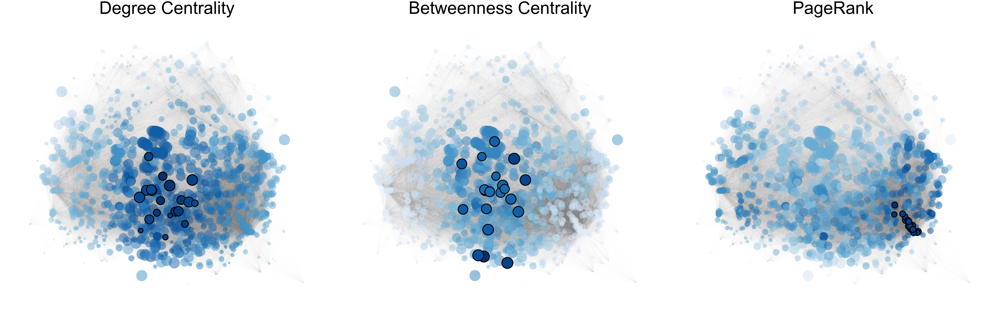

In [24]:
# plot centralities, with darker colors indicating more important nodes
full_params = {'edge_width':0.025,
               'circled_node_alpha':0.5,
               'title_font_size':100}
fig, ax = plt.subplots(ncols=3, figsize=(80,25))

draw_correlation_graph(graph, ax[0], deg_colors, gg_sizes_dict, params=full_params, title="Degree Centrality", circled_nodes=deg_nodes)
draw_correlation_graph(graph, ax[1], bet_colors, gg_sizes_dict, params=full_params, title="Betweenness Centrality", circled_nodes=bet_nodes)
draw_correlation_graph(graph, ax[2], pr_colors, gg_sizes_dict, params=full_params, title="PageRank", circled_nodes=pr_nodes)
fig.tight_layout()

## Figure S18

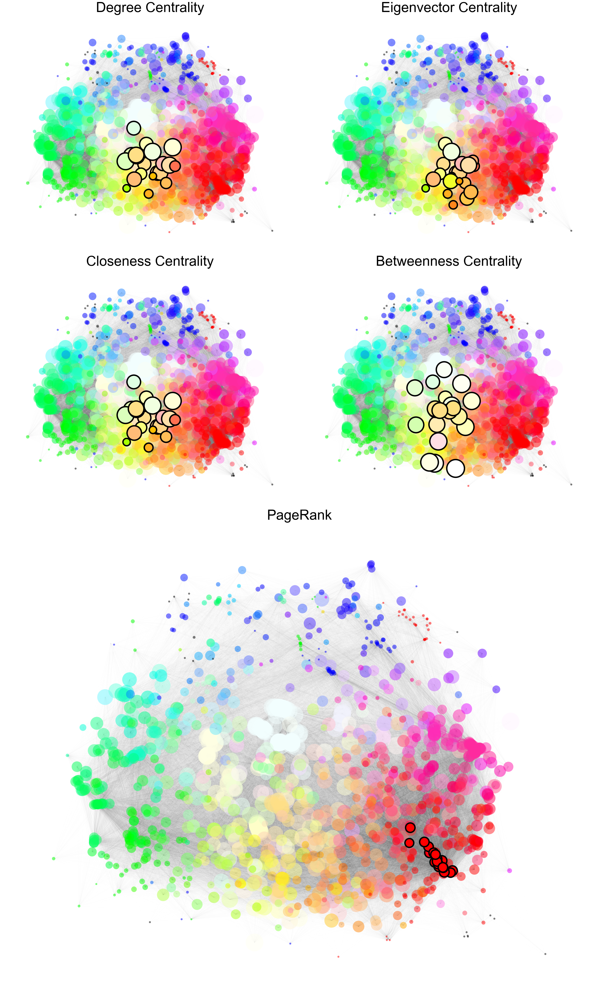

In [25]:
# full set of centrality graphs colored based on RST distribution
full_params = {'edge_width':0.025,
               'circled_node_alpha':0.5,
               'title_font_size':50}

fig = plt.figure(figsize=(30, 50))
gs = gridspec.GridSpec(3, 2, height_ratios=[1, 1, 2])

# set up subplots
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])
ax5 = fig.add_subplot(gs[2, :])

draw_correlation_graph(graph, ax1, gg_colors_dict, gg_sizes_dict, params=full_params, title="Degree Centrality", circled_nodes=deg_nodes)
draw_correlation_graph(graph, ax2, gg_colors_dict, gg_sizes_dict, params=full_params, title="Eigenvector Centrality", circled_nodes=eig_nodes)
draw_correlation_graph(graph, ax3, gg_colors_dict, gg_sizes_dict, params=full_params, title="Closeness Centrality", circled_nodes=close_nodes)
draw_correlation_graph(graph, ax4, gg_colors_dict, gg_sizes_dict, params=full_params, title="Betweenness Centrality", circled_nodes=bet_nodes)
draw_correlation_graph(graph, ax5, gg_colors_dict, gg_sizes_dict, params=full_params, title="PageRank", circled_nodes=pr_nodes)

fig.tight_layout()

# Table S5

In [26]:
def centrality_ranks(graph, metric):
    cent = metric(graph)
    cent = dict(sorted(cent.items(), key=lambda item: item[1], reverse=True))
    cent = pd.DataFrame(list(cent.items()), columns=['gene group', 'centrality'])
    cent['rank'] = cent['centrality'].rank(ascending=False, method='min').astype(int)
    cent["sequence"] = cent["gene group"].apply(lambda x: seq_dict.get(x, "Unknown"))
    cent = cent[["rank", "gene group", "centrality", "sequence"]]
    return cent

centrality_metrics = {
    'Degree': nx.degree_centrality,
    'Eigenvector': nx.eigenvector_centrality,
    'Closeness': nx.closeness_centrality,
    'Betweenness': nx.betweenness_centrality,
    'PageRank': nx.pagerank
}
with pd.ExcelWriter("../4_SupplementaryMaterial/table_s5.xlsx") as writer:
    for name, metric in centrality_metrics.items():
        cent = centrality_ranks(graph, metric)
        cent.to_excel(writer, sheet_name=name, index=False)